## [Transformata Fouriera](https://github.com/kzajac/Mownit2018/blob/master/Mownit_Lab7.ipynb)


In [2]:
using Plots
using FFTW
using WAV

### Zadanie 1.
Zamień sygnał na sumę sygnałów np
```julia
x = sin.(2*pi*t*200) + 2* sin.(2*pi*t*400) 
```

  Zaobserwuj wynik transformaty i wyjaśnij go.
<p>

In [3]:
# sampling rate
f = 1024;
t = 0:1/(f-1):1;
x = sin.(2*pi*t*200) + 2* sin.(2*pi*t*400);

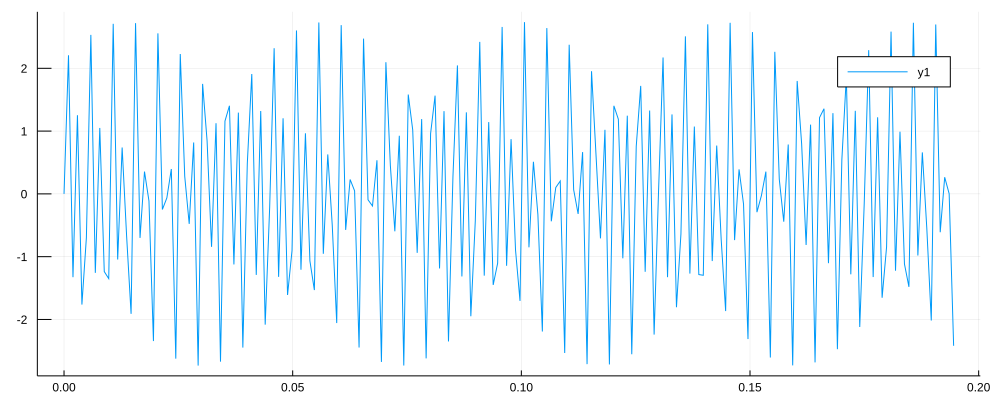

In [4]:
# otrzymujemy poniższy sygnał
plot(t[1:1:200],x[1:1:200],size=(1000,400))

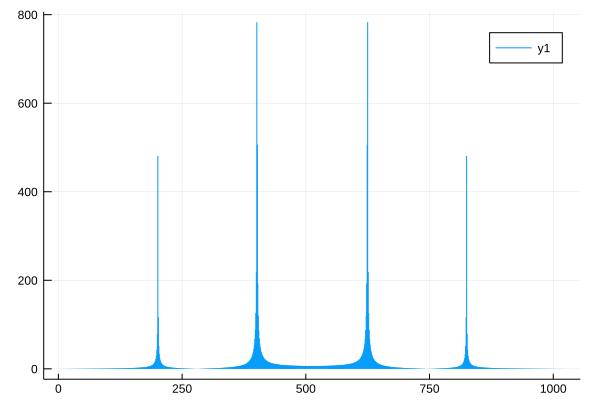

In [5]:
y = fft(x)
sticks(abs.(y))

### Zadanie 2. 
1. Wypełniamy tablicę wartościami funkcji cosinus ("sygnału") zaburzonej niewielkim "szumem" np. dodając do każdej wartości wylosowaną liczbę funkcją rand().
2. Prosze narysować wykres zaszumionej funkcji.
3. Narysować wykres transformaty Fouriera (widmo)  tego sygnału (jak poprzednio).
4. Po transformacie wyzerowac w widmie wszystkie elementy, których wartość bezwzględna jest mniejsza niz 50. W ten sposób usuwamy "szumy" z sygnału.
5. Przeprowadzić odwrotną transformatę funkcją ifft(). Narysować wykres otrzymanej funkcji dla <b> częsci  rzeczywistej</b>. Porównać z wejściowym wykresem sygnału.


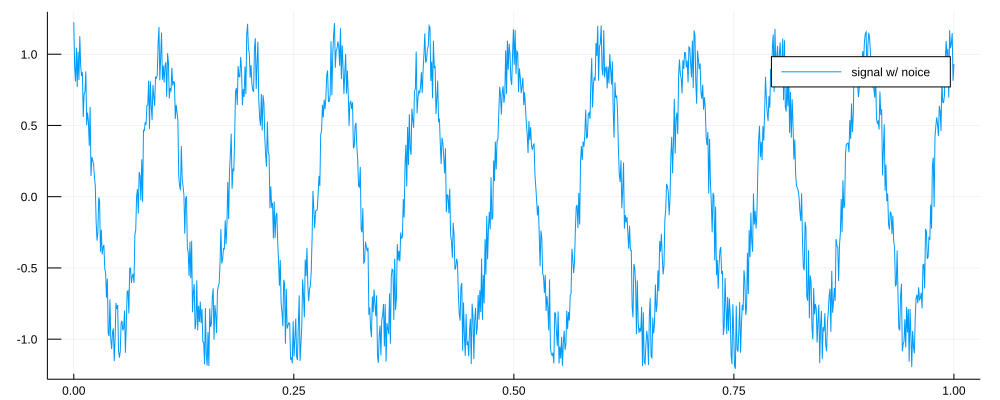

In [12]:
# sampling rate
f = 1024;
t = 0:1/(f-1):1;
x = [cos.(2*pi*tn*10) + 0.5 * (rand() - 0.5) for tn in t]
plot(t,x,size=(1000,400),label="signal w/ noice")

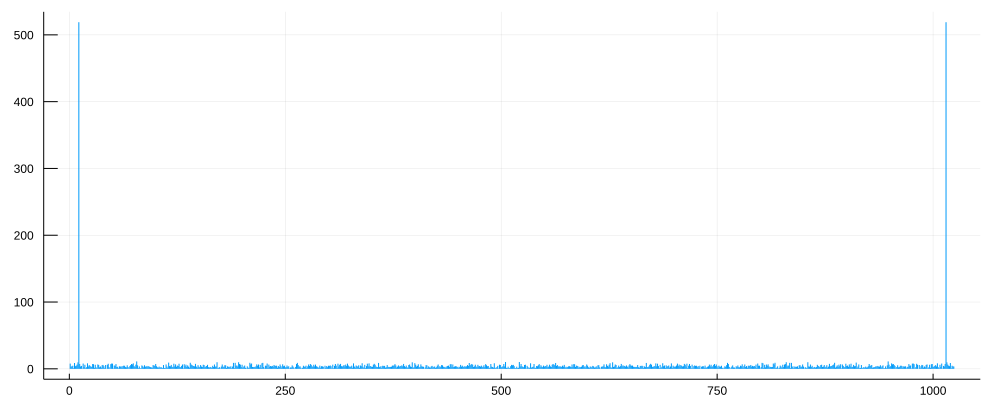

In [8]:
y = fft(x)
sticks(abs.(y),size=(1000,400),legend=:none)

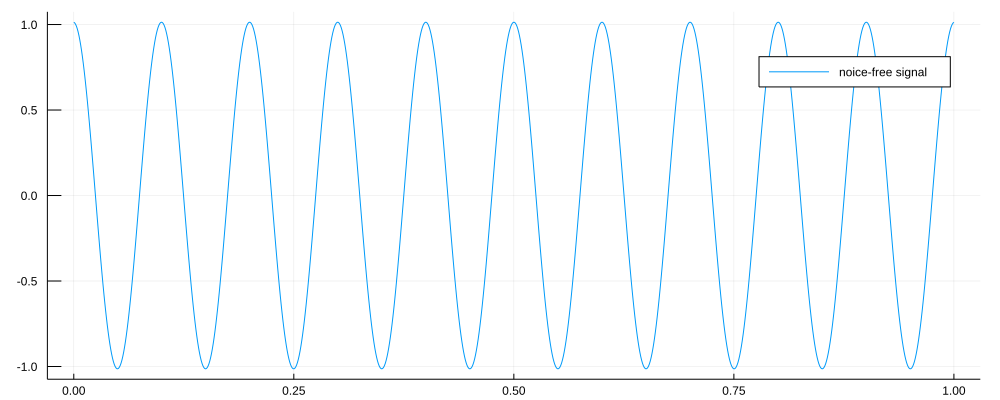

In [13]:
# noice cancellation
ynf = Complex{Float64}[if (abs(yn) > 50) yn else 0 end for yn in y]
xnf = ifft(ynf)
plot(t,real.(xnf),size=(1000,400),label="noice-free signal")

### Zadanie 3.
Proszę nagrać własny glos i zastosować na nim trasformatę Fouriera, narysować wykres widma. Następnie poeksperymentować (wyciąć wybrane częstotliwości), dokonać odwrotnej transformaty i odsłuchać efekt.

_W repozytorium **nie został** zamieszczony plik dźwiękowy_ letitbe.wav.

In [14]:
s, fs = wavread("letitbe.wav")
plot(s,
    size=(1000,400),
    label="Channel 1",
    xlabel="sample #",
    ylabel="amplitude",
    ylims=(-0.5,0.5),
    legend=:topright
)

In [23]:
wavplay(s, fs)

In [18]:
function plot_f(f, fs)
    samples = length(f)
    range = (1:1:samples) * fs/samples
    plot(range, abs.(f),
        size=(1000,400),
        xlabel="freq (Hz)",
        ylabel="amplitude",
        legend=:none)
end

plot_f (generic function with 1 method)

In [19]:
f = fft(s)
plot_f(f, fs)

In [157]:
function cut_range(f, fs, min, max)
    samples = length(f)
    range = (1:1:samples) * fs/samples
    result = [if (xf > min && xf < max) x * 0 else x end
                for (x, xf) in zip(f, range)]
end

cut_range (generic function with 1 method)

In [158]:
xd = cut_range(f, fs, 0, 57)
xd = cut_range(xd, fs, 0, 300)
xd = cut_range(xd, fs,  1000, fs)

plot_f(xd, fs)

In [159]:
xdd = real.(ifft(xd))
plot(s,
    size=(1000,400),
    label="Channel 1",
    xlabel="sample #",
    ylabel="amplitude",
    ylims=(-0.5,0.5),
    legend=:bottomright
)
plot!(xdd,
    label="Channel 1 (0-1 kHz cancelled)"
)

In [160]:
wavplay(xdd, fs)

In [115]:
wavplay(s, fs)